In [1]:
import tifffile
from matplotlib import pyplot as plt
import numpy as np
import deeptrack as dt
import tensorflow as tf
import pandas as pd

/home/gideon/Documents/PhD/Projects/Oxford-collaboration/.venv/lib/python3.11/site-packages/deeptrack/backend/_config.py:11: UserWarning: cupy not installed. GPU-accelerated simulations will not be possible
  warnings.warn(
/home/gideon/Documents/PhD/Projects/Oxford-collaboration/.venv/lib/python3.11/site-packages/deeptrack/backend/_config.py:25: UserWarning: cupy not installed, CPU acceleration not enabled
  warnings.warn("cupy not installed, CPU acceleration not enabled")
2023-12-11 14:14:03.045552: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-12-11 14:14:03.047402: I external/local_tsl/tsl/cuda/cudart_stub.cc:31] Could not find cuda drivers on your machine, GPU will not be used.
2023-12-11 14:14:03.072931: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.

In [2]:
ALPHA = 0.99
CUTOFF = 0.9
RADIUS = 0.03
TRAJACTORY_MIN = 10

In [3]:
import tifffile

tiff_path = r'../data/experimental/Spike_LowDensity.tiff'
#tiff_path = r'../data/simulated/Sim_results_High.tiff'
#csv_path = r'../data/simulated/Sim_HighDensity.csv'

# Load images
images = tifffile.imread(tiff_path,  key=range(300, 1100, 1))

# Normalize
images = images - np.mean(images)
images = images / np.std(images, axis=(0, 1, 2), keepdims=True) / 3

images = images[300:]
images.shape

(500, 81, 128)

In [4]:
# Define Models

# LoadSTAR
name = "size_20_AffineAdd"
loadSTAR = dt.models.LodeSTAR(input_shape=(None, None, 1))
loadSTAR.load_weights(f"../data/weights/loadstar/{name}/{name}")

# MAGIK
magik = dt.models.gnns.MAGIK(
    dense_layer_dimensions=(
        64,
        96,
    ),  # number of features in each dense encoder layer
    base_layer_dimensions=(
        96,
        96,
        96,
    ),  # Latent dimension throughout the message passing layers
    number_of_node_features=2,  # Number of node features in the graphs
    number_of_edge_features=1,  # Number of edge features in the graphs
    number_of_edge_outputs=1,  # Number of predicted features
    edge_output_activation="sigmoid",  # Activation function for the output layer
    output_type="edges",  # Output type. Either "edges", "nodes", or "graph"
    graph_block="MPN",
)
magik.load_weights(f"../data/weights/magik/MAGIK_MP_MPN.h5")

In [5]:
# Detect
alpha = 0.99
cutoff = 0.1
detections_all = loadSTAR.predict_and_detect(images, alpha=alpha, beta=1-alpha, cutoff=cutoff)

detections_all_new = []
for detection in detections_all:
    detections_all_new.append(np.delete(detection, np.where((detection[:, 0] < 5) | (detection[:, 1] < 5) | (detection[:, 1] > 121) | (detection[:, 0] > 75))[0], axis=0))

detections_all = detections_all_new

16/16 [==============================] - 1s 76ms/step


In [6]:
# Make detections into Pandas DataFrame
size = 0
for detections in detections_all:
    size += detections.shape[0]
print(size)

detection_array = np.zeros((size, 6))

traversed = 0
for i, detections in enumerate(detections_all):
    detection_array[traversed:traversed+detections.shape[0], 0] = i
    detection_array[traversed:traversed+detections.shape[0], 4:] = detections
    traversed += detections.shape[0]

detection_df = pd.DataFrame(
    detection_array, 
    columns=['frame', 'set', 'label', 'solution', 'centroid-1', 'centroid-0']).astype({'set': 'int32', 'frame': 'int32', 'label': 'int32', 'solution': 'int32', 'centroid-1' : 'float32', 'centroid-0' : 'float32'}
)
detection_df['centroid-1'] /= images.shape[1]
detection_df['centroid-0'] /= images.shape[2]

del(detections_all)



28625


In [99]:
# Traject
variables = dt.DummyFeature(
    radius=0.03,
    output_type='edges',
    nofframes=3, # time window to associate nodes (in frames) 
)

pred, gt, scores, graph = dt.models.gnns.get_predictions(
    detection_df, ["centroid"], magik, **variables.properties()
)
edges_df, nodes, _ = dt.models.gnns.df_from_results(pred, gt, scores, graph)
# Get trajectories from results
traj = dt.models.gnns.get_traj(edges_df, th = TRAJACTORY_MIN)

Creating graph edges...


100%|██████████| 1/1 [00:09<00:00,  9.66s/it]
/home/gideon/Documents/PhD/Projects/Oxford-collaboration/.venv/lib/python3.11/site-packages/deeptrack/models/gnns/utils.py:12: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value 'False' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  d.loc[


/home/gideon/Documents/PhD/Projects/Oxford-collaboration/.venv/lib/python3.11/site-packages/deeptrack/models/gnns/utils.py:52: FutureWarning: Calling int on a single element Series is deprecated and will raise a TypeError in the future. Use int(ser.iloc[0]) instead
  alpha = 0.1 + d_alpha * int(solutions[i : i + 1]["frame_y"])
/home/gideon/Documents/PhD/Projects/Oxford-collaboration/.venv/lib/python3.11/site-packages/deeptrack/models/gnns/utils.py:54: FutureWarning: Calling int on a single element Series is deprecated and will raise a TypeError in the future. Use int(ser.iloc[0]) instead
  if not (str(int(solutions[i : i + 1]["node_x"])) in t.keys()):
/home/gideon/Documents/PhD/Projects/Oxford-collaboration/.venv/lib/python3.11/site-packages/deeptrack/models/gnns/utils.py:55: FutureWarning: Calling int on a single element Series is deprecated and will raise a TypeError in the future. Use int(ser.iloc[0]) instead
  t[str(int(solutions[i : i + 1]["node_x"]))] = next(color)
/home/gideon/D

/tmp/ipykernel_58852/2895649919.py:19: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(detections[-1, 2] * images.shape[2], detections[-1, 1] * images.shape[1], linewidths=1.5, c = c)
/tmp/ipykernel_58852/2895649919.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(15, 15))


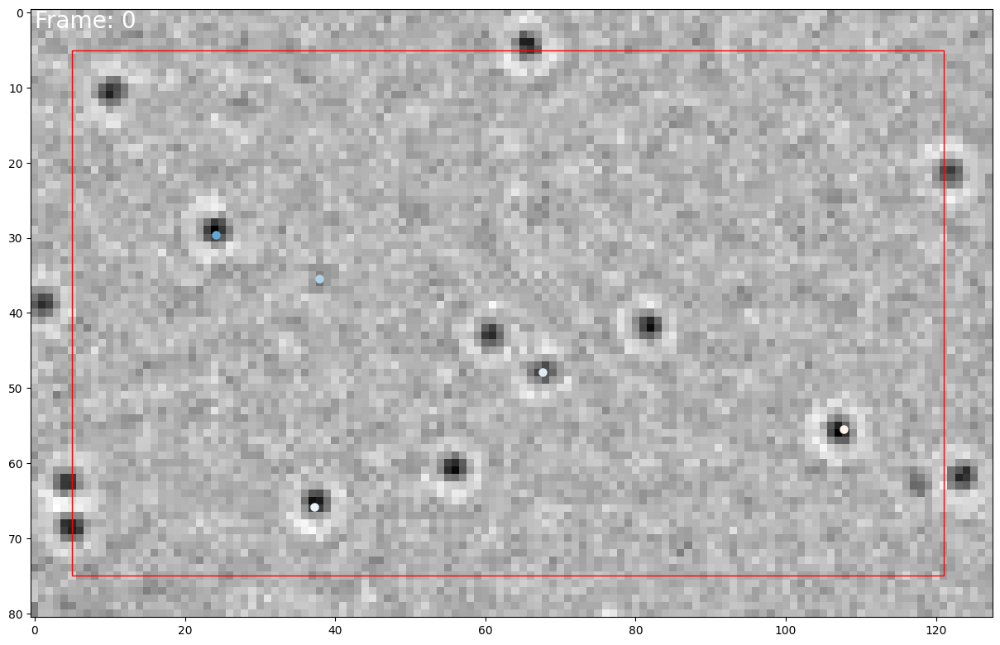

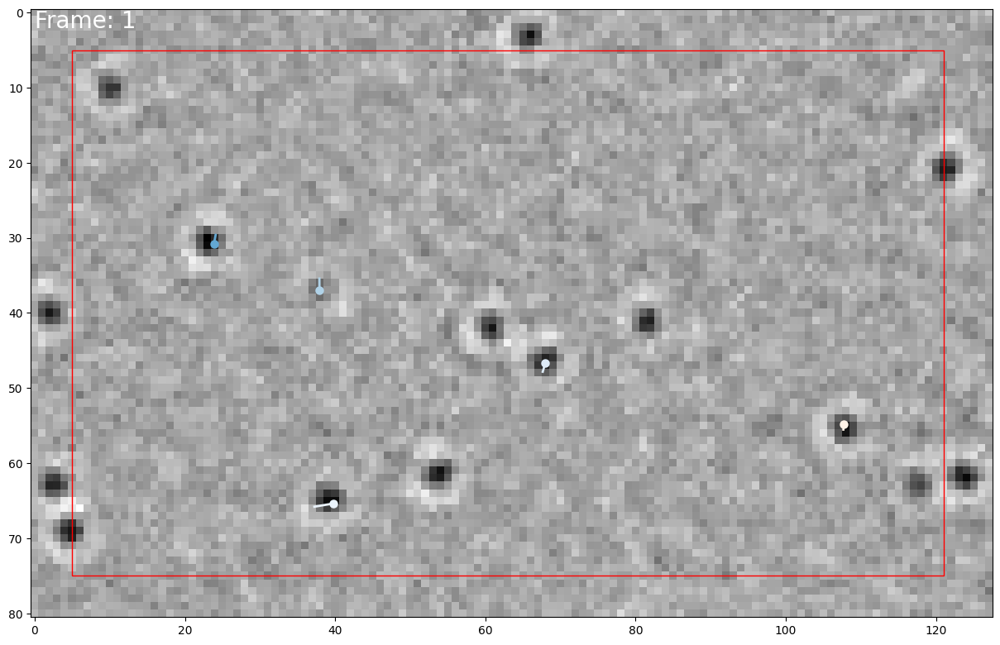

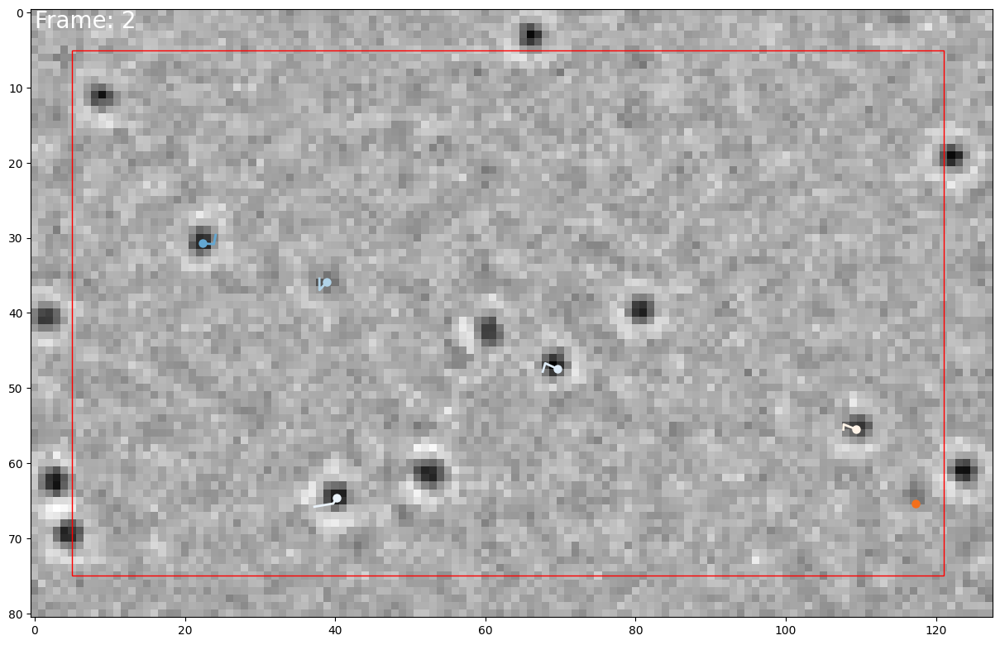

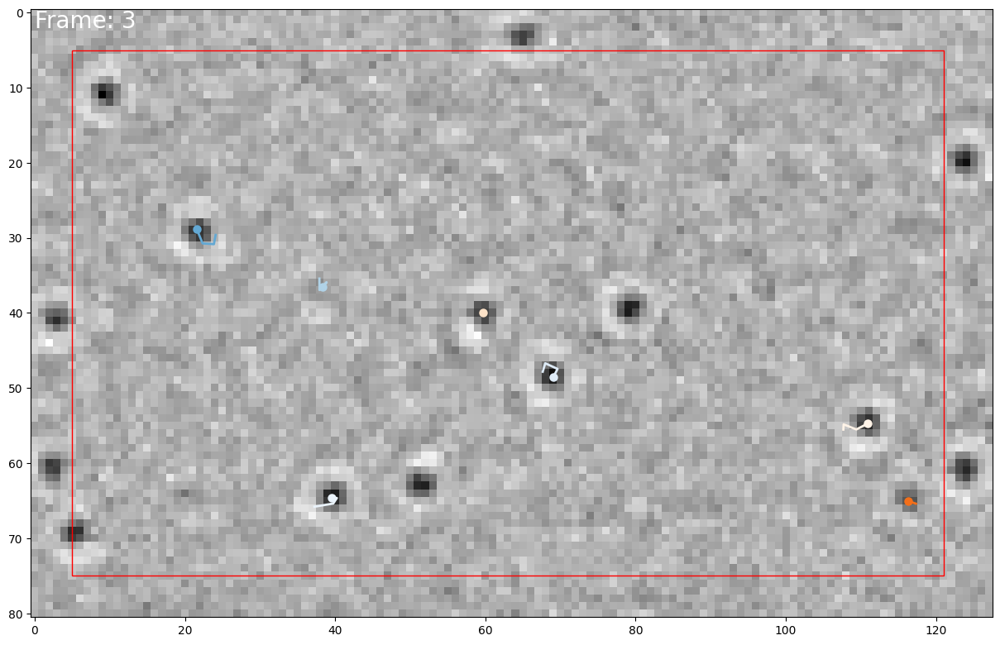

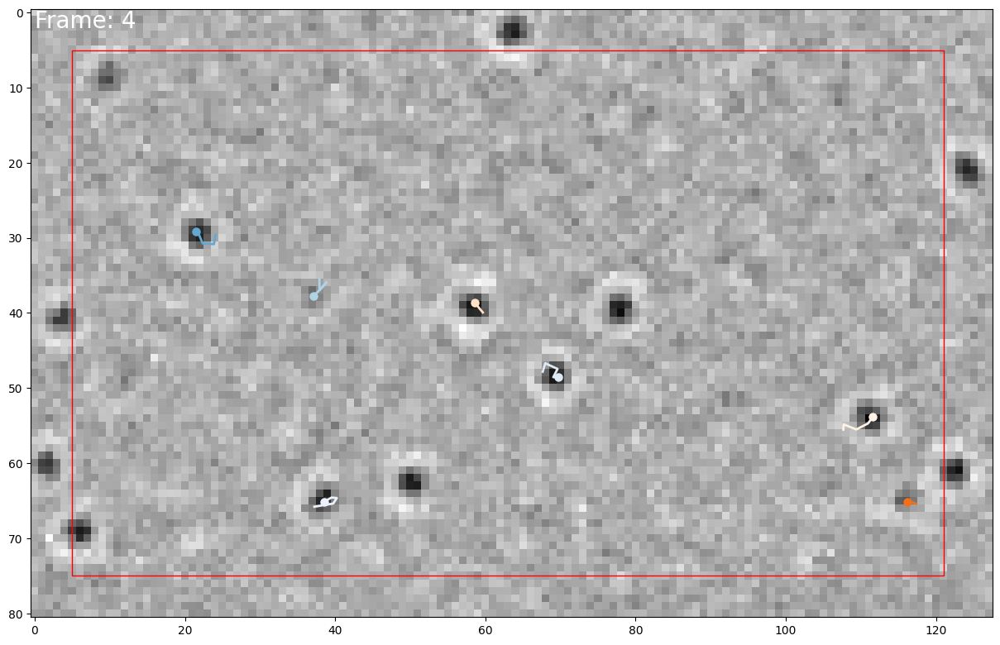

...

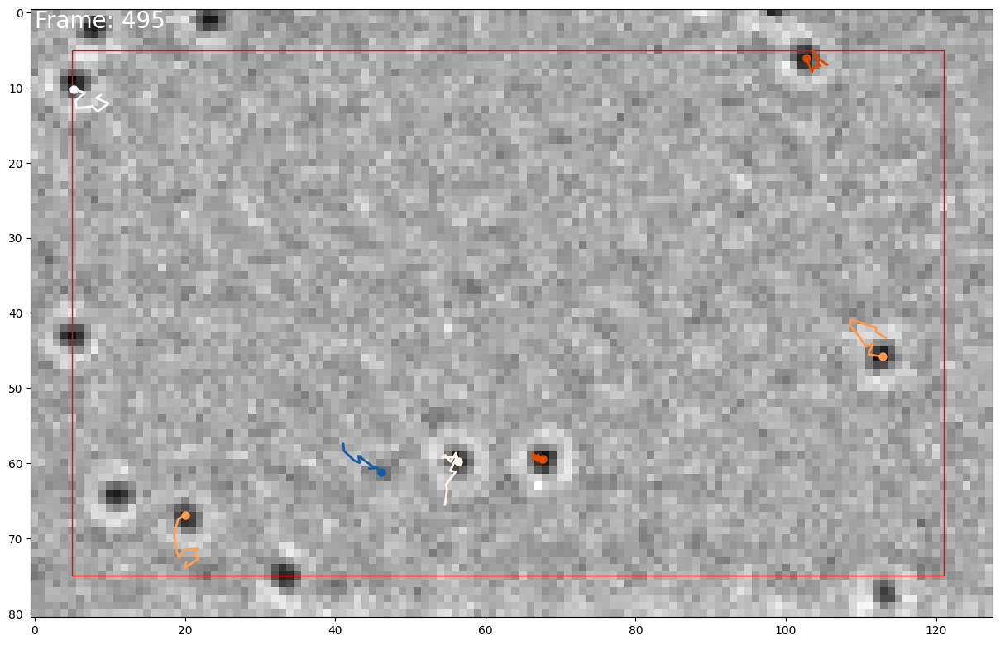

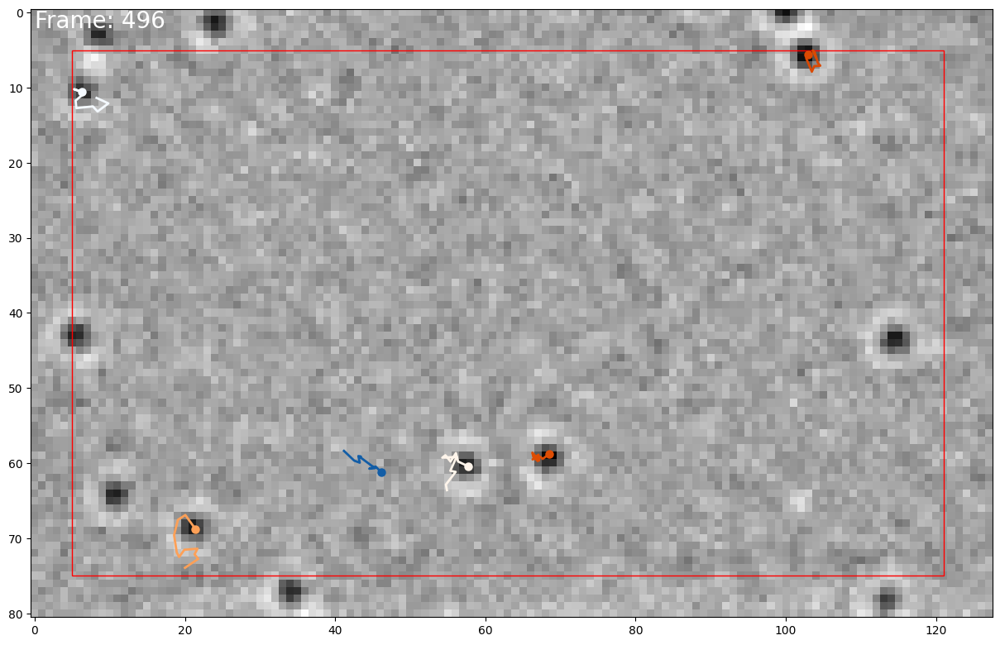

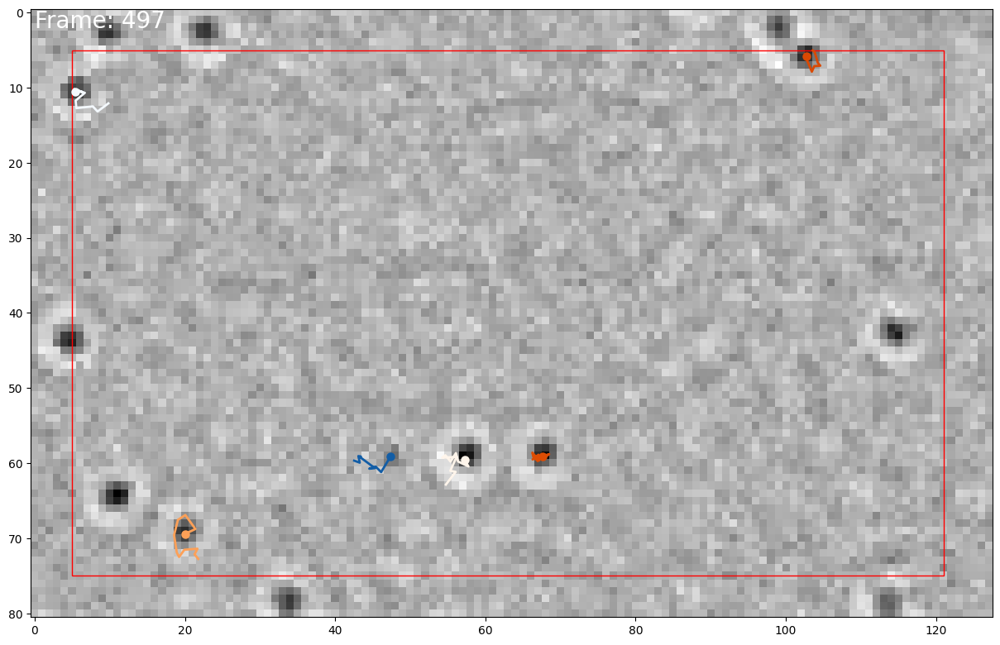

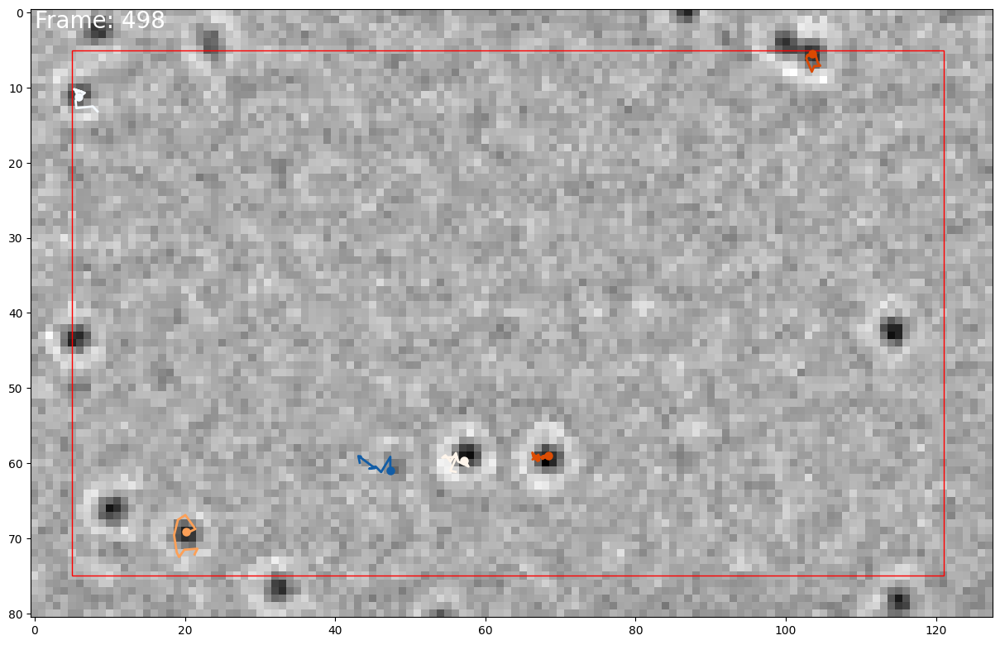

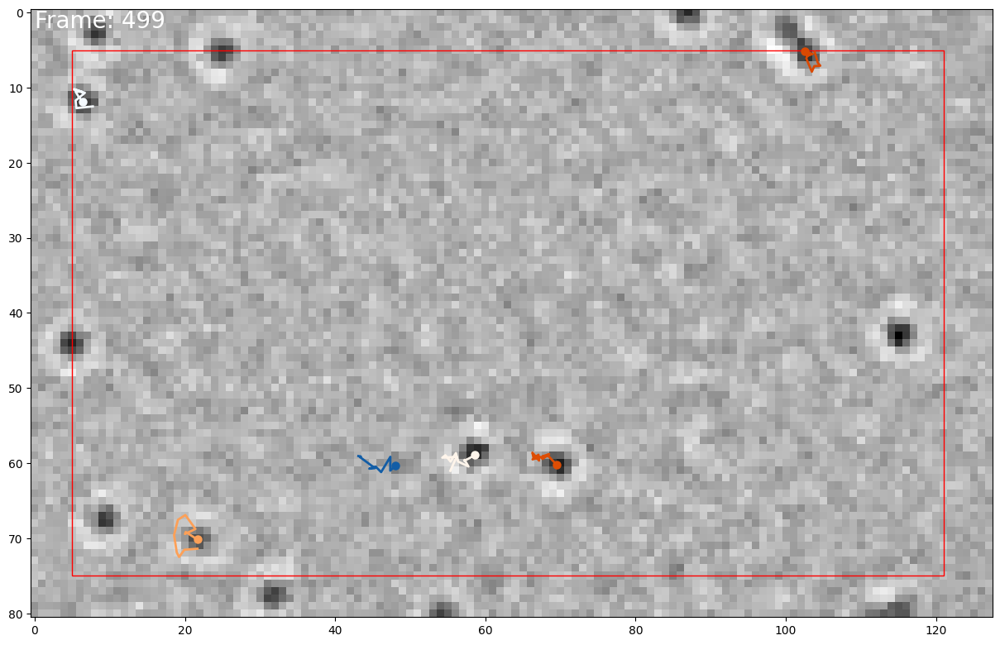

In [100]:
import matplotlib.patches as patches


# Plot
for f, image in enumerate(images):
    plt.figure(figsize=(15, 15))
    plt.imshow(image, cmap='gray')
    rect = patches.Rectangle((5, 5), 121-5, 75-5, linewidth=1, edgecolor='r', facecolor='none')
    plt.gca().add_patch(rect)
    plt.text(0, 2, "Frame: " + str(f), fontsize=20, c="white")

    for i, (t, c) in enumerate(traj):
        detections = nodes[t][(nodes[t, 0] <= f) & (nodes[t, 0] >= f - 10), :]

        if (len(detections) == 0) or (np.max(nodes[t, 0]) < f):
            continue

        plt.plot(detections[:, 2] * images.shape[2], detections[:, 1] * images.shape[1], color = c, linewidth=2)
        plt.scatter(detections[-1, 2] * images.shape[2], detections[-1, 1] * images.shape[1], linewidths=1.5, c = c)
    
    plt.savefig(f"../data/output/trajected_images/fig_{str(f).zfill(4)}.png")
    if f > 500:
        break